In [1]:
# Librerias...............................

import numpy as np
import io
import wave
import librosa
import librosa.display
import matplotlib.pylab as plt
from math import sqrt
from pydub import AudioSegment
import IPython
import os
import pandas as pd

C:\Users\ASUS\anaconda3\lib\site-packages\pydub\utils.py:170: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)


In [7]:
def cut_silence_ind(filename,output,name,orig_wav,orig_spec,mod_spec,length):
    # Plot del audio ----------------------------------------------------------
    duration=librosa.get_duration(filename=filename)

    y, sr = librosa.load(filename,sr=16000, duration=duration)
    
    if orig_wav==True:
        plt.figure(figsize=(25, 10))
        librosa.display.waveplot(y, sr=sr)
        plt.title('Audio')

    # Plot del Espectrograma ----------------------------------------------------------
    D = librosa.stft(y,n_fft=512,hop_length=128)  # STFT of y
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max);
    print(S_db.shape)

    if orig_spec==True:
        fig, ax = plt.subplots(figsize=(25, 10));
        img = librosa.display.specshow(S_db, x_axis='time', y_axis='linear', ax=ax, sr=sr,hop_length=128);
        ax.set(title='Spectrograma Original');

    if mod_spec==True:
        fig, ax = plt.subplots(figsize=(25, 10));
        img = librosa.display.specshow(S_db, x_axis='time', y_axis='linear', ax=ax, sr=sr,hop_length=128);
        ax.set(title='{}'.format(name));

    # Obtencion de la Magnitud -----------------------------------------------------
    frq=np.abs(D)**2

    #Parametros
    lin=(128*duration)/y.shape[0]  #Equivalencia de 128 muestas que es el hop lenght - hop*durac(seg)/num_muestas
    ini=lin
    f=1  #Variable para ifs
    init=0 #Variable para grafica de linea de inicio de silencio
    fin=0  #Variable para grafica de linea de fin de silencio
    dt=0   #Variable para cantidad de energia en intervalo
    cortes_init=[] #Lista para guardar donde son los cortes
    cortes_fin=[]
    inter=[]

    for i in range(frq.shape[1]):
        dest=np.mean(frq[:,i])

        if dest>0.5:
            if f==1:
                init=ini
                #print('init:{}'.format(dest))
                f=2
        if f==2:
            if dest<0.001:
                f=1
                fin=ini
                #print('fin:{}'.format(dest))
                if (fin-init)>0.15:
                    #dt=dt/(fin-init) # Cantidad de energia existence relativa
                    #print('dt:{}'.format(dt))
                    if dt>2:
                        #print('dt:{}'.format(dt))
                        length.append(fin-init)
                        cortes_init.append(init)
                        cortes_fin.append(fin)
                        inter.append(init)
                        inter.append(fin)
                        plt.axvline(x=init-0.02,color='blue')
                        plt.axvline(x=fin-0.02,color='red')
                        dt=0
                    else:
                        dt=0
                else:
                    dt=0
            elif i==(frq.shape[1]-1):
                fin=ini
                cortes_init.append(init)
                cortes_fin.append(fin)
                inter.append(init)
                inter.append(fin)
                plt.axvline(x=init,color='blue')
                plt.axvline(x=fin,color='red')
            else:
                dt=dt+dest
        ini=ini+lin
        
    Audio = AudioSegment.from_wav(filename)
    new_audio=0


    for i in range(len(cortes_init)):
        corte=Audio[cortes_init[i]*1000:cortes_fin[i]*1000]
        new_audio=new_audio+corte
        #corte.export('{}_{}.wav'.format(output,i), format="wav") #Exports t

    print(inter)
    np.savetxt('{}.txt'.format(output), inter)
    new_audio.export(output, format="wav") #Exports t
        
    return cortes_init,cortes_fin, length

In [14]:
length=[]

<ipython-input-13-0aff802e35d0>:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(25, 10));


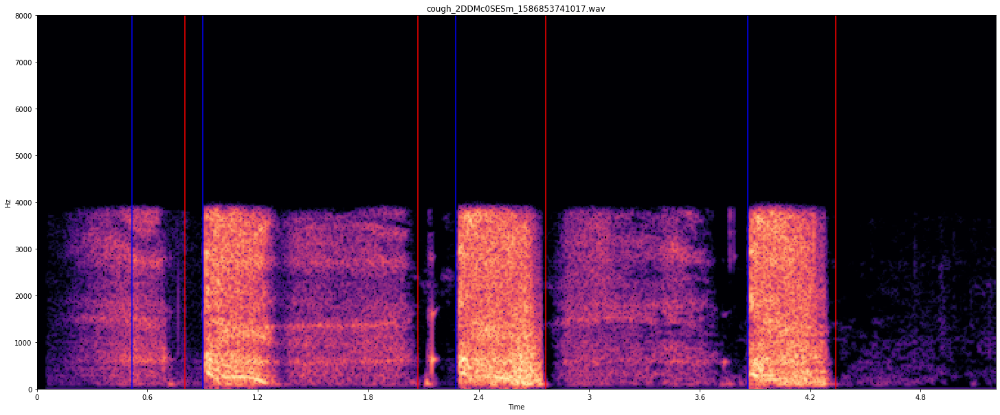

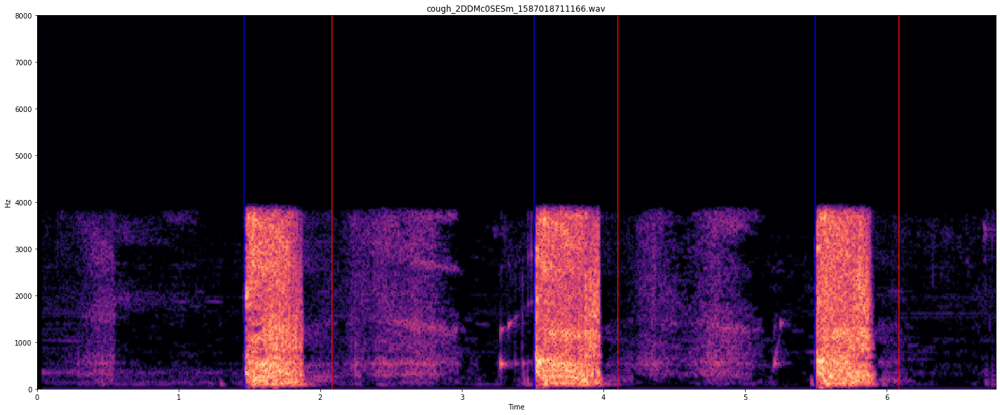

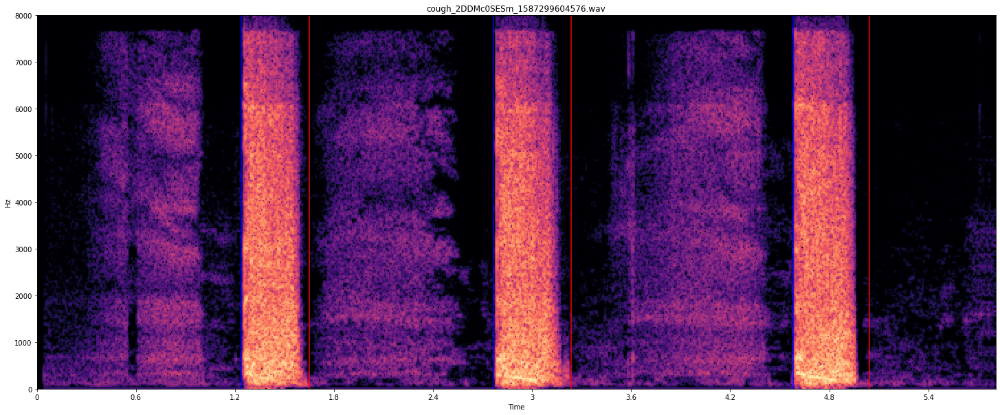

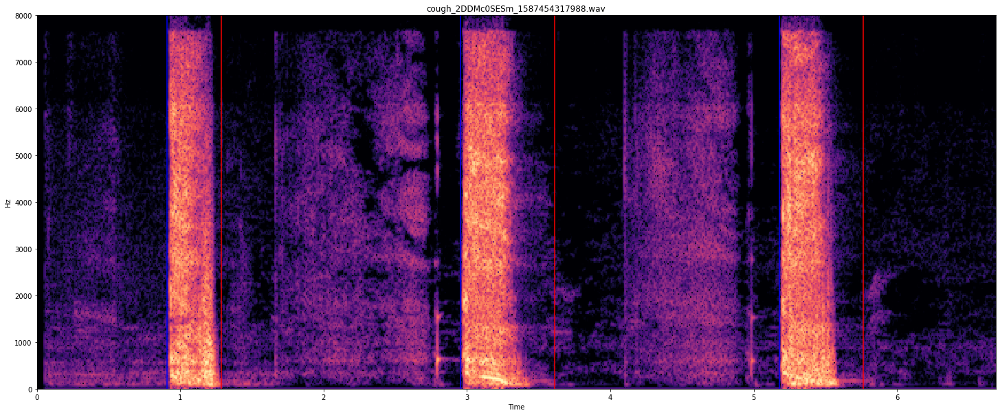

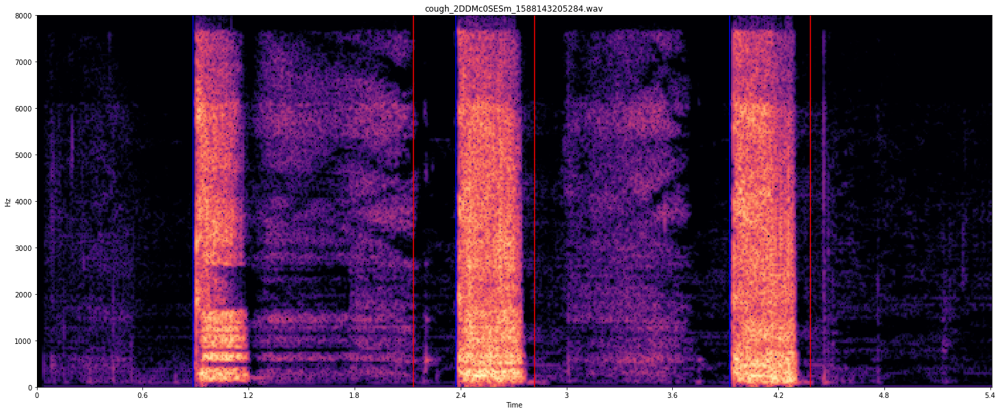

...

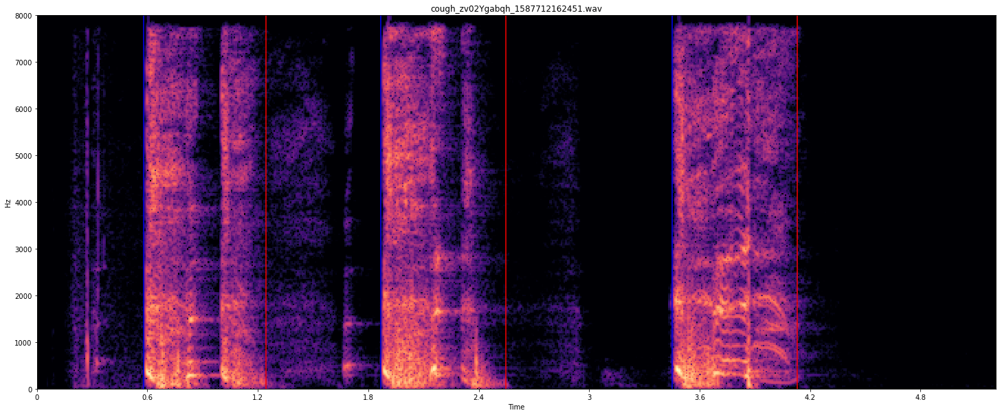

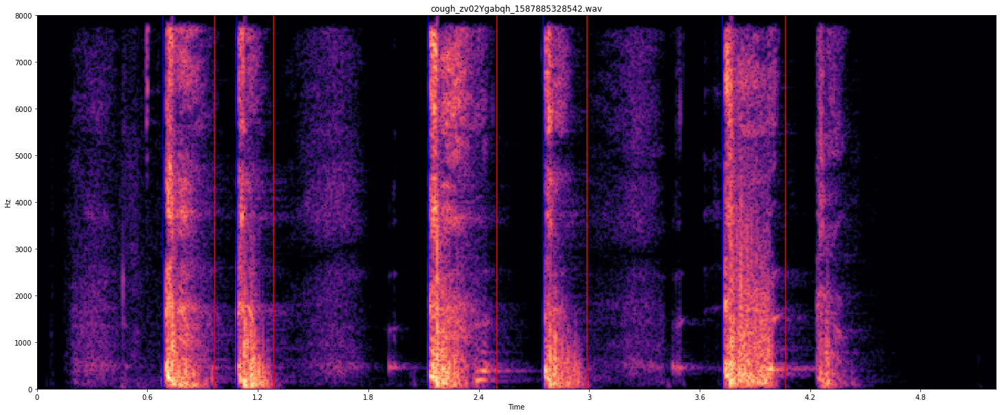

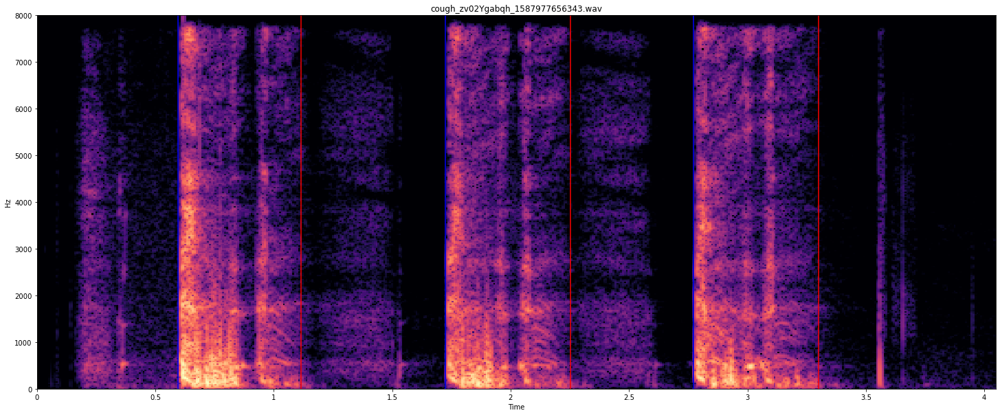

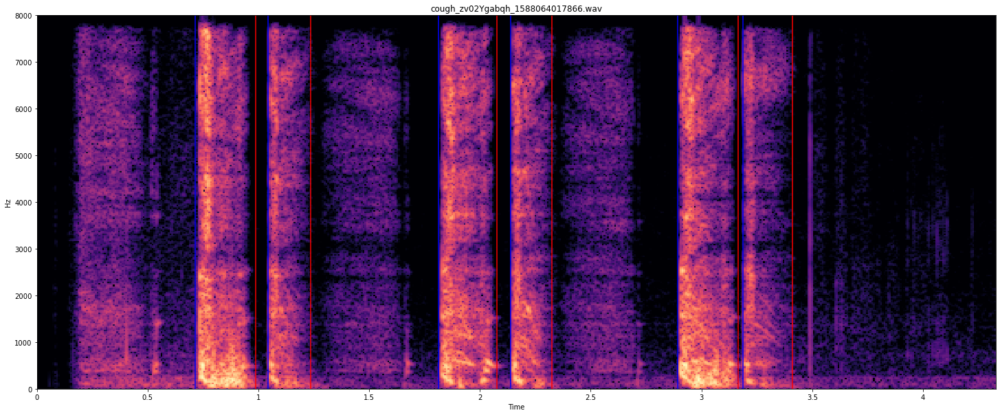

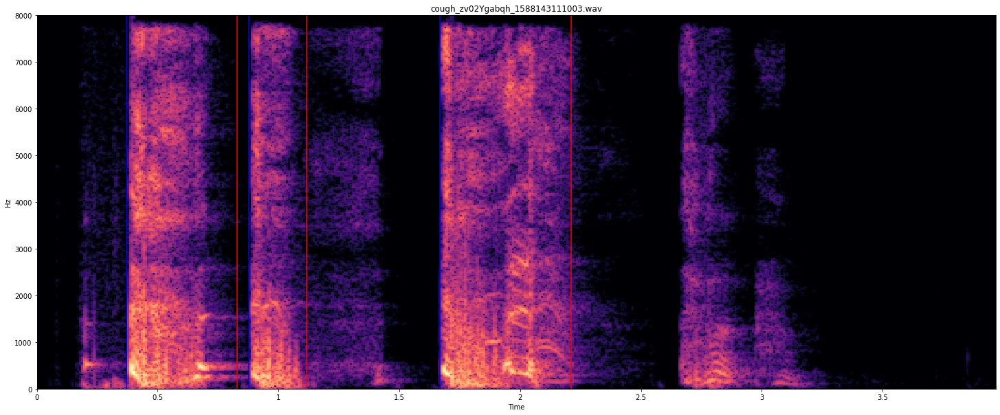

In [15]:
path_ingreso=r'C:\Users\ASUS\Desktop\David\Proyectos\Proyecto_Cepra\Base_de_datos\Base_Cambridge\CovidAndroidWithCough_Camb'
path_salida=r'C:\Users\ASUS\Desktop\David\Proyectos\Proyecto_Cepra\Base_de_datos\Audios_Cortados\CovidAndroidWithCough_Camb'
files=os.listdir(path_ingreso)


for i in range(len(files)):
    cortes_init,cortes_fin, length=cut_silence_ind("{}/{}".format(path_ingreso,files[i]),"{}/{}".format(path_salida,files[i]),files[i],False,False,True,length)
    #IPython.display.display(IPython.display.Audio("{}/{}".format(path_ingreso,files[i])))
    #IPython.display.display(IPython.display.Audio("{}/{}".format(path_salida,files[i])))


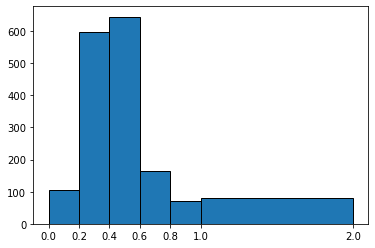

mean: 0.47739267040479083
min: 0.10399999999999987
max: 3.3280000000000025


In [384]:
var=length
plt.figure()
df = pd.DataFrame({"x":length})    
bins= [0,0.20,0.40,0.60,0.80,1,2]
plt.hist(df.values, bins=bins, edgecolor="k")
plt.xticks(bins)
plt.show()
#print(length)
print('mean: {}'.format(np.mean(length)))
print('min: {}'.format(np.min(length)))
print('max: {}'.format(np.max(length)))


(257, 796)
[1.256000000000001, 1.5920000000000012, 1.7280000000000013, 2.0800000000000014, 3.3040000000000025, 3.5840000000000027, 3.696000000000003, 3.928000000000003, 4.824000000000003, 5.504000000000004]


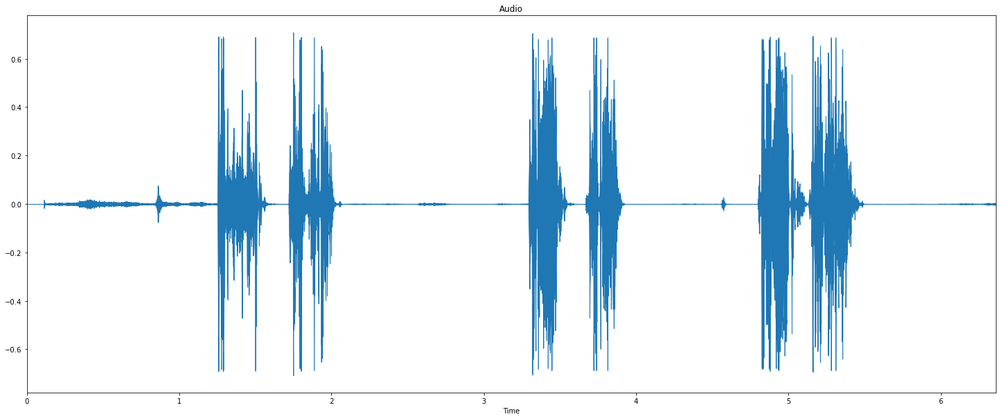

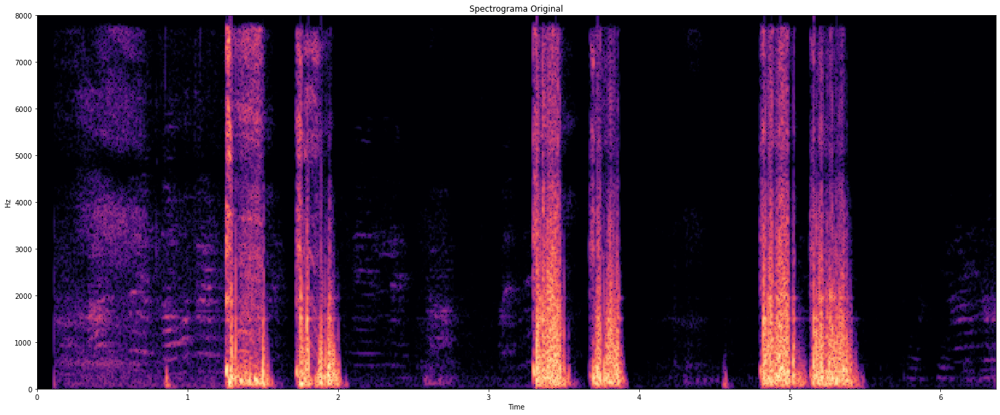

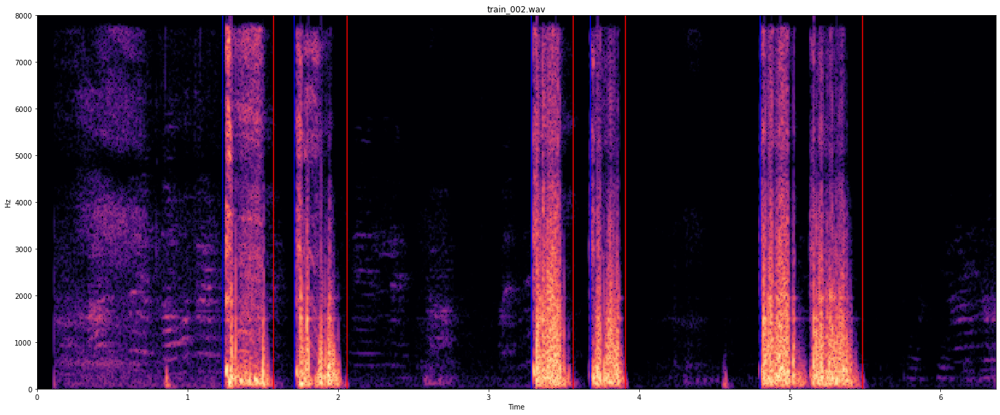

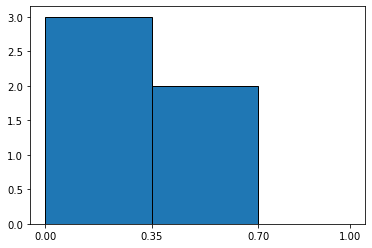

[0.3360000000000003, 0.3520000000000001, 0.28000000000000025, 0.2320000000000002, 0.6800000000000006]
mean: 0.3760000000000003
min: 0.2320000000000002
max: 0.6800000000000006


In [10]:
path_ingreso=r'C:\Users\ASUS\Desktop\David\Proyectos\Proyecto_Cepra\Base_de_datos\CCS_Tos_Cambrid\wav\training'
path_salida=r'C:\Users\ASUS\Desktop\David\Proyectos\Proyecto_Cepra'
file='train_002.wav'
file_2='resul.wav'
length=[]

cortes_init,cortes_fin, length=cut_silence_ind("{}/{}".format(path_ingreso,file),"{}/{}".format(path_salida,file_2),file,True,True,True, length)
IPython.display.display(IPython.display.Audio("{}/{}".format(path_ingreso,file)))
#IPython.display.display(IPython.display.Audio("{}/{}".format(path_salida,file_2)))

plt.figure()
df = pd.DataFrame({"x":length})

bins= [0,0.35,0.7,1]
plt.hist(df.values, bins=bins, edgecolor="k")
plt.xticks(bins)
plt.show()
print(length)
print('mean: {}'.format(np.mean(length)))
print('min: {}'.format(np.min(length)))
print('max: {}'.format(np.max(length)))

0.5360000000000004
1.1600000000000008
1.9680000000000015
2.664000000000002
3.688000000000003
3.792000000000003
3.848000000000003
4.656000000000003


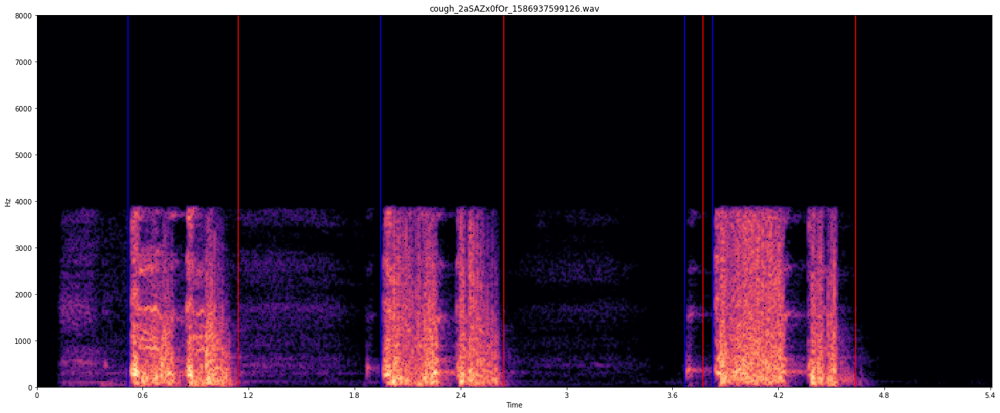

In [9]:
path_ingreso=r'C:\Users\ASUS\Desktop\David\Proyectos\Proyecto_Cepra\Base_de_datos\Base_Cambridge\AsmaAndroidConTos'
path_salida=r'C:\Users\ASUS\Desktop\David\Proyectos\Proyecto_Cepra\Base_de_datos\Audios_Cortados\AsmaAndroidConTos'
file='cough_2aSAZx0fOr_1586937599126.wav'

cortes_init,cortes_fin=cut_silence_ind("{}/{}".format(path_ingreso,file),"{}/{}".format(path_salida,file),file,False,False,True)
IPython.display.display(IPython.display.Audio("{}/{}".format(path_ingreso,file)))
IPython.display.display(IPython.display.Audio("{}/{}".format(path_salida,file)))